This notebook explores scene graph generation using an LLM out of the box.

# Setup

## Notebook Setup

Google Colab
- Google Colab secrets: add a Gemini API key as `GOOGLE_API_KEY`. May be pre-populated from a previous session.
    - Need to create an account for Gemini and grab a key there.

In [1]:
from google import genai
from PIL import Image, ImageDraw, ImageColor
import json
import random
import urllib.request
import cv2
import sys
from dotenv import load_dotenv
import os
import numpy as np

GOOGLE_COLAB = 'google.colab' in sys.modules

In [2]:
GEMINI_API_KEY = None
if GOOGLE_COLAB:
    from google.colab import userdata
    GEMINI_API_KEY = userdata.get('GOOGLE_API_KEY')
else:
    load_dotenv()
    GEMINI_API_KEY = os.environ.get('GOOGLE_API_KEY')

gemini_client = genai.Client(api_key=GEMINI_API_KEY)
gemini_model = "gemini-1.5-flash"

In [3]:
kitchen_portrait = Image.open("img/kitchen_portrait.jpg")

## Get objects and stuff

Taken from https://cs.stanford.edu/people/jcjohns/cvpr15_supp/

In [4]:
classes = {}

objects_raw = """
airplane	arm	arrow	awning	backpack	bag
ball	bananas	banner	bar	basket	bat
beach	beanie	beard	bed	belt	bench
bicycle	bike	blanket	blinds	board	boat
book	books	boots	bottle	bowl	box
boy	bridge	building	buildings	bus	bush
bushes	buttons	cabinet	cabinets	cake	camera
cap	car	carpet	cars	cart	cat
ceiling	chair	child	chimney	clock	cloud
clouds	coat	collar	computer	cone	container
controller	cord	couch	counter	cow	crowd
cup	curb	curtain	curtains	desk	dirt
dog	door	doors	dress	driver	ear
ears	elephant	engine	eye	eyes	face
faucet	fence	flag	floor	flower	flowers
food	fork	frame	girl	glass	glasses
glove	gloves	goggles	grass	ground	guy
hair	hand	handle	handles	hands	hat
head	headlight	headlights	helmet	hill	hood
horse	house	jacket	jeans	keyboard	kid
kite	knife	ladder	lady	lamp	laptop
leaves	legs	lettering	letters	license plate	lid
light	lights	line	lines	logo	luggage
man	men	microwave	mirror	monitor	motorcycle
mountain	mountains	mouse	mouth	napkin	necklace
net	nose	number	numbers	pants	paper
pavement	people	person	phone	picture	pillow
pizza	plane	plant	plants	plate	platform
player	pole	poles	post	poster	pot
purse	rack	racket	rail	railing	ramp
reflection	refrigerator	remote	ring	road	rocks
roof	rope	rug	sand	sandals	scarf
screen	seat	shadow	shelf	shirt	shoe
shoes	shorts	sidewalk	sign	sink	skateboard
skirt	skis	sky	sneakers	snow	snowboard
socks	speaker	spoon	stairs	stand	steps
sticker	stove	strap	street	stripe	stripes
suit	suitcase	sunglasses	surfboard	sweater	table
tail	television	tent	text	tie	tire
tires	toilet	towel	tower	tracks	traffic light
train	trash can	tray	tree	trees	truck
trunk	tv	umbrella	uniform	van	vase
vest	wall	watch	water	wheel	wheels
window	windows	windshield	wing	wires	woman
words	writing"""

attributes_raw = """
alive	aluminum	asian	asphalt
bald	bare	beige	bent
big	black	black and white	blond
blonde	blue	brick	bright
brown	brunette	calm	caucasian
cement	circular	clean	clear
closed	cloudy	cold	colorful
concrete	cooked	covered	curly
curved	dark	denim	dirty
driving	dry	eating	empty
fabric	fat	filled	flat
floating	fluffy	flying	fresh
full	furry	glass	gold
gray	green	grey	hanging
happy	hard	heavy	high
huge	in motion	large	leafy
leaning	leather	light	lit
long	looking	messy	metal
moving	multicolored	murky	narrow
new	not moving	off	old
on	open	orange	overcast
painted	paper	parked	patterned
paved	pink	plaid	plastic
playing	powered on	pretty	purple
rectangular	red	red and white	reflective
round	rubber	running	rusted
rusty	sharp	shiny	short
shut	silver	sitting	skiing
skinny	small	smiling	snowy
soft	square	stacked	standing
steel	stone	stopped	straight
striped	talking	tall	tan
teal	thick	thin	tile
tiled	transparent	turned on	upright
walking	watching	wet	white
wide	wood	wooden	yellow
young"""

relations_raw = """above	across from
adjacent to	against
along	around
at	attached to
before	behind
below	beneath
beside	between
by	carrying
connected to	contains
covered by	covering
crossing	cutting
driving	eating
facing	floating on
hanging on	has
has on	holding
in	in front of
inside	leaning on
left of	looking at
lying on	moving on
near	next to
on	on top of
outside	over
parked next to	parked on
playing	pulling
riding	right of
says	sitting near
sitting next to	sitting on
standing near	standing next to
standing on	stopped on
swinging	taller than
tied to	touching
under	using
walking on	watching
wearing	with"""

In [5]:
def process(raw):
    """
    Convert raw text to list of words.
    """
    result = []
    raw = raw.strip()
    for line in raw.split("\n"):
        result += line.split("\t")
    print(f"Found {len(result)} words")
    return result

In [6]:
# create a dictionary of ids and words
object_bank = process(objects_raw)
attribute_bank = process(attributes_raw)
relation_bank = process(relations_raw)
id_bank = {
    "objects": list(enumerate(object_bank)),
    "attributes": list(enumerate(attribute_bank)),
    "relations": list(enumerate(relation_bank)),
}

Found 266 words
Found 145 words
Found 68 words


## Util

In [7]:
additional_colors = [colorname for (colorname, colorcode) in ImageColor.colormap.items()]

# a list of colors for drawing
colors = [
    'red',
    'green',
    'blue',
    'yellow',
    'orange',
    'pink',
    'purple',
    'brown',
    'gray',
    'beige',
    'turquoise',
    'cyan',
    'magenta',
    'lime',
    'navy',
    'maroon',
    'teal',
    'olive',
    'coral',
    'lavender',
    'violet',
    'gold',
    'silver',
] + additional_colors

In [8]:
def denormalize(bounding_box, width, height):
    """
    Given a set of normalized coordinates of a bounding box, returns the absolute coordinates.

    Gemini works in normalized coordinates, so we need to process it to draw it.

    Takes (y1, x1, y2, x2) in a normalized format.

    Returns (x1, y1, x2, y2) relative to the original image.
    """
    y1, x1, y2, x2 = bounding_box
    res = [x1/1000 * width, y1/1000 * height, x2/1000 * width, y2/1000 * height]
    return (int(z) for z in res)

In [9]:
def plot_bounding_boxes(img, object_tuples, color=None, font_size=None, line_width=None):
    """
    Plots bounding boxes on an image with markers for each noun phrase, using PIL, normalized coordinates, and different colors.

    Args:
    - img: the PIL image.
    - object_tuples: A list of tuples containing the noun phrases and their positions in normalized [y1 x1 y2 x2] format.
    - color (str): The color to use for the lines and text. If not provided, a random color is chosen for each relationship.
    - font_size (int): The font size to use for the text. If not provided, it is calculated based on the image width.
    - line_width (int): The width of the lines. If not provided, it is calculated based on the image width.
    """
    width, height = img.size

    if not font_size:
        font_size = width // 60
    if not line_width:
        line_width = width // 600

    draw = ImageDraw.Draw(img)

    for object_id, bounding_box in object_tuples:
        _color = colors[random.randint(0, len(colors)-1)] if color is None else color

        # denormalize coordinates (see helper)
        abs_x1, abs_y1, abs_x2, abs_y2 = denormalize(bounding_box, width, height)

        # draw bounding box
        draw.rectangle(
            ((abs_x1, abs_y1), (abs_x2, abs_y2)),
            outline=_color,
            width=line_width
        )

        # draw text
        draw.text((abs_x1 + 8, abs_y1 + 6), object_id, fill=_color, font_size=font_size)

    # Display the image
    # img.show()

In [10]:
def center(bounding_box):
    """
    Returns the center coordinate of the bounding box.

    Assumes the bounding box is already denormalized.

    Returns:
    - Center point as (x, y)
    """
    x1, y1, x2, y2 = bounding_box
    return (x1 + x2) // 2, (y1 + y2) // 2

def draw_relationships(image, graph, label="full", color=None, font_size=None, line_width=None, verbose=False):
    """
    Draws relationship lines on an image between bounding boxes.

    Args:
    - image (PIL.Image): The image to draw on.
    - graph (dict): The graph object containing the objects and relationships.
    - label (str): The type of label to draw. Can be "full" or "short".
    - color (str): The color to use for the lines and text. If not provided, a random color is chosen for each relationship.
    - font_size (int): The size of the font to use.
    - line_width (int): The width of the line to draw.
    - verbose (bool): Whether to print errors.

    Returns:
    - PIL.Image: The image with relationships drawn.
    """
    width, height = image.size

    if not font_size:
        font_size = width // 60
    if not line_width:
        line_width = width // 600
    
    errors = 0

    draw = ImageDraw.Draw(image)

    for i, (obj_id1, obj_id2, relation_id) in enumerate(graph["relations"]):
        relation_name = relation_bank[relation_id]

        if obj_id1 not in graph["objects"] or obj_id2 not in graph["objects"]:
            if verbose:
                if obj_id1 not in graph["objects"]:
                    print(f"Skipping relation {obj_id1} {relation_name} {obj_id2} because {obj_id1} not found in objects")
                if obj_id2 not in graph["objects"]:
                    print(f"Skipping relation {obj_id1} {relation_name} {obj_id2} because {obj_id2} not found in objects")
            errors += 1
            continue
        
        _color = colors[random.randint(0, len(colors)-1)] if color is None else color

        # get center of both objects
        bb1 = graph["objects"][obj_id1]["bounding_box"]
        bb2 = graph["objects"][obj_id2]["bounding_box"]
        center1 = center(denormalize(bb1, width, height))
        center2 = center(denormalize(bb2, width, height))

        # compute midpoint for labeling
        mid_x = (center1[0] + center2[0]) // 2
        mid_y = (center1[1] + center2[1]) // 2

        # get categories
        c1 = graph["objects"][obj_id1]["category"]
        c2 = graph["objects"][obj_id2]["category"]

        if c1 >= len(object_bank) or c2 >= len(object_bank):
            if verbose:
                if c1 not in object_bank:
                    print(f"Skipping relation {obj_id1} {relation_name} {obj_id2} because id {c1} not found in object bank")
                if c2 not in object_bank:
                    print(f"Skipping relation {obj_id1} {relation_name} {obj_id2} because id {c2} not found in object bank")
            errors += 1
            continue

        # draw line connecting centers
        draw.line([center1, center2], fill=_color, width=line_width)

        # draw relation text
        relation_text = f"{object_bank[c1]} {relation_name} {object_bank[c2]}" if label == "full" else relation_name
        draw.text((mid_x, mid_y), relation_text, fill=_color, font_size=font_size)
    
    if verbose and errors > 0:
        print(f"Skipped {errors} relations")
    
    return errors

In [11]:
def response_to_json(res):
    """
    Takes the output of a model and returns the parsed result.

    May need to clean up the output if it is a code chunk.
    """
    if res.startswith("```json"):
        res = res[7:-4]
    
    try:
        return json.loads(res)
    except:
        raise ValueError(f"Could not parse JSON: {res}")

In [12]:
def get_resized(image, max_size=1200):
    """
    Displays a resized version of the image for faster loading.

    Args:
    - image (PIL.Image): The original image.
    - max_size (int): The maximum width or height of the resized image.

    Returns:
    - PIL.Image: The resized image (does not modify the original).
    """
    # Get original size
    width, height = image.size

    # Compute new size while maintaining aspect ratio
    scale = min(max_size / width, max_size / height)
    new_size = (int(width * scale), int(height * scale))

    # Resize and show
    resized_image = image.resize(new_size, Image.Resampling.LANCZOS)
    # resized_image.show()

    return resized_image

In [13]:
def generate_video(filename, frames, fps=2):
    """
    Generates a video from a list of frames.

    Args:
    - filename (str): The output filename.
    - frames (list): List of PIL.Image frames.
    - fps (int): Frames per second for the video.
    """
    # Get size of first frame
    width, height = frames[0].size

    # Initialize video writer
    video = cv2.VideoWriter(filename, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    # Write each frame
    for frame in frames:
        # Convert to BGR
        frame = cv2.cvtColor(np.array(frame), cv2.COLOR_RGB2BGR)

        # Write to video
        video.write(frame)

    # Release video writer
    video.release()

In [14]:
def generate_scene_graph(img):
    response = gemini_client.models.generate_content(
        model=gemini_model,
        contents=[
            img,
            json.dumps(id_bank),
            """
            Return a scene graph for this image in a JSON format. You must adhere to
            the following rules:
            1. Do not include any additional text.
            2. Use this JSON format:
            {
                "objects": {
                    "object_id1": {
                        "category": <object_category_id>,
                        "bounding_box": [ymin, xmin, ymax, xmax],
                        "attributes": [<attr_id1>, <attr_id2>]
                    },
                    ...
                },
                "relations": [
                    ["object_id1", "object_id2", <relation_id>],
                    ...
                ]
            }
            3. You may create object_ids by using a word or short phrase to describe
            the object with a number, joined by underscores (eg. "book_1"). Object ids
            must be unique.
            4. The bounding box coordinates must be accurate.
            5. object_category_id, attr_id1, and relation_id must refer to the ids
            given in the id bank under the objects, attributes, and relations sections
            respectively. All ids must correspond to a valid id in the given id bank
            and accurately describe the object, attribute, or relation in the image.
            6. object_ids in relations must reference a valid object in "objects".
            7. Do not include trailing commas.
            """,
        ],
        config={
            "response_mime_type": "application/json"
        }
    ).text

    graph = response_to_json(response)
    return graph

In [46]:
def generate_scene_graph_with_context(img, prev_sg=None):
    contents = [
        img,
        json.dumps(id_bank),
        """
        Return a scene graph for this image in a JSON format. You must adhere to
        the following rules:
        1. Do not include any additional text.
        2. Use this JSON format:
        {
            "objects": {
                "object_id1": {
                    "category": <object_category_id>,
                    "bounding_box": [ymin, xmin, ymax, xmax],
                    "attributes": [<attr_id1>, <attr_id2>]
                },
                ...
            },
            "relations": [
                ["object_id1", "object_id2", <relation_id>],
                ...
            ]
        }
        3. You may create object_ids by using a word or short phrase to describe
        the object with a number, joined by underscores (eg. "book_1"). Object ids
        must be unique.
        4. The bounding box coordinates must be numerical and accurate.
        5. object_category_id, attr_id1, and relation_id must refer to the ids
        given in the id bank under the objects, attributes, and relations sections
        respectively. All ids must correspond to a valid id in the given id bank
        and accurately describe the object, attribute, or relation in the image.
        6. object_ids in relations must reference a valid object in "objects".
        7. Do not include trailing commas.
        8. You may be provided with a previous scene graph to use as context. You should
        reference this to generate a new scene graph that is consistent with the previous
        scene graph.
        9. Consistency is defined as follows: objects referring to the same object should
        be assigned the same object_id, and relations describing the same relationship
        should be assigned the same relation_id. For example, it is discouraged to respond
        "table next to counter" if the previous scene graph describes "table adjacent to counter".
        """
    ]

    if prev_sg:
        contents.append(json.dumps(prev_sg))

    response = gemini_client.models.generate_content(
        model=gemini_model,
        contents=contents,
        config={
            "response_mime_type": "application/json"
        }
    ).text

    graph = response_to_json(response)
    return graph

## Grab video frames

In [55]:
zipnerf_video_path = "img/zipnerf.mp4"

# check if video already exists
if not os.path.exists(zipnerf_video_path):
    # download from source
    print("Downloading video...")
    zipnerf_video_url = "https://jonbarron.info/zipnerf/img/teaser.mp4"
    urllib.request.urlretrieve(zipnerf_video_url, zipnerf_video_path)
    print(f"Video downloaded to {zipnerf_video_path}.")
else:
    print(f"Video already available locally at {zipnerf_video_path}.")

Video already available locally at img/zipnerf.mp4.


In [56]:
# read in and process
zipnerf_video = cv2.VideoCapture(zipnerf_video_path)
zipnerf_livingroom_time = [4, 10]
zipnerf_kitchen_time = [10, 12]

In [57]:
# from google.colab.patches import cv2_imshow

def extract_frames(video, start_time, spacing_seconds, num_frames):
    """
    Extracts frames from a video starting at a given time and spacing.

    Args:
    - start_time (int): The time in seconds to start extracting frames.
    - spacing_seconds (float): The time in seconds between each frame.
    - num_frames (int): The number of frames to extract.

    Returns:
    - List[PIL.Image]: The extracted frames.
    """
    fps = video.get(cv2.CAP_PROP_FPS)
    print(f"Frame rate: {fps} FPS")
    frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
    print(f"Total frames: {frame_count}")

    start_frame = int(start_time * fps)
    spacing_frames = int(spacing_seconds * fps)
    cur_frame = start_frame
    video_frames = []

    for i in range(num_frames):
        cur_frame = start_frame + i * spacing_frames
        video.set(cv2.CAP_PROP_POS_FRAMES, cur_frame)
        success, image = video.read()
        if success:
            # filename = f"frame_{i}.jpg"
            # cv2.imwrite(filename, image)
            # print(f"Saved frame {filename}")

            image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            pil_image = Image.fromarray(image_rgb)
            video_frames.append(pil_image)
        else:
            print("Failed to retrieve frame.")
    
    return video_frames

In [58]:
sample_frames = extract_frames(zipnerf_video, zipnerf_kitchen_time[0], 0.1, 3)
shortvid_frames = extract_frames(zipnerf_video, zipnerf_kitchen_time[0] - 1, 0.05, 60)

Frame rate: 60.0 FPS
Total frames: 1920
Frame rate: 60.0 FPS
Total frames: 1920


# 1 Scene Graph Generation

## POC

In [19]:
kitchen_portrait_graph = generate_scene_graph(kitchen_portrait)
kitchen_portrait_graph

{'objects': {'microwave_1': {'category': 140,
   'bounding_box': [150, 197, 352, 566],
   'attributes': [109, 76]},
  'cabinets_1': {'category': 39,
   'bounding_box': [0, 0, 386, 999],
   'attributes': [141, 6]},
  'stove_1': {'category': 217,
   'bounding_box': [443, 113, 760, 618],
   'attributes': [71, 134]},
  'toaster_oven_1': {'category': 247,
   'bounding_box': [448, 51, 528, 286],
   'attributes': [9, 76]},
  'dishwasher_1': {'category': 247,
   'bounding_box': [665, 477, 999, 930],
   'attributes': [109, 76]},
  'counter_1': {'category': 63,
   'bounding_box': [386, 0, 699, 999],
   'attributes': [28, 121]},
  'bottles_1': {'category': 27,
   'bounding_box': [479, 610, 602, 726],
   'attributes': [133]},
  'pitcher_1': {'category': 251,
   'bounding_box': [495, 722, 691, 865],
   'attributes': [50, 133]},
  'paper_towel_1': {'category': 155,
   'bounding_box': [470, 855, 659, 966],
   'attributes': [85, 139]},
  'bowl_1': {'category': 28,
   'bounding_box': [607, 864, 704, 99

In [20]:
object_tuples = [(object_name, kitchen_portrait_graph["objects"][object_name]["bounding_box"]) for object_name in kitchen_portrait_graph["objects"]]
plot_bounding_boxes(kitchen_portrait, object_tuples)
draw_relationships(kitchen_portrait, kitchen_portrait_graph)

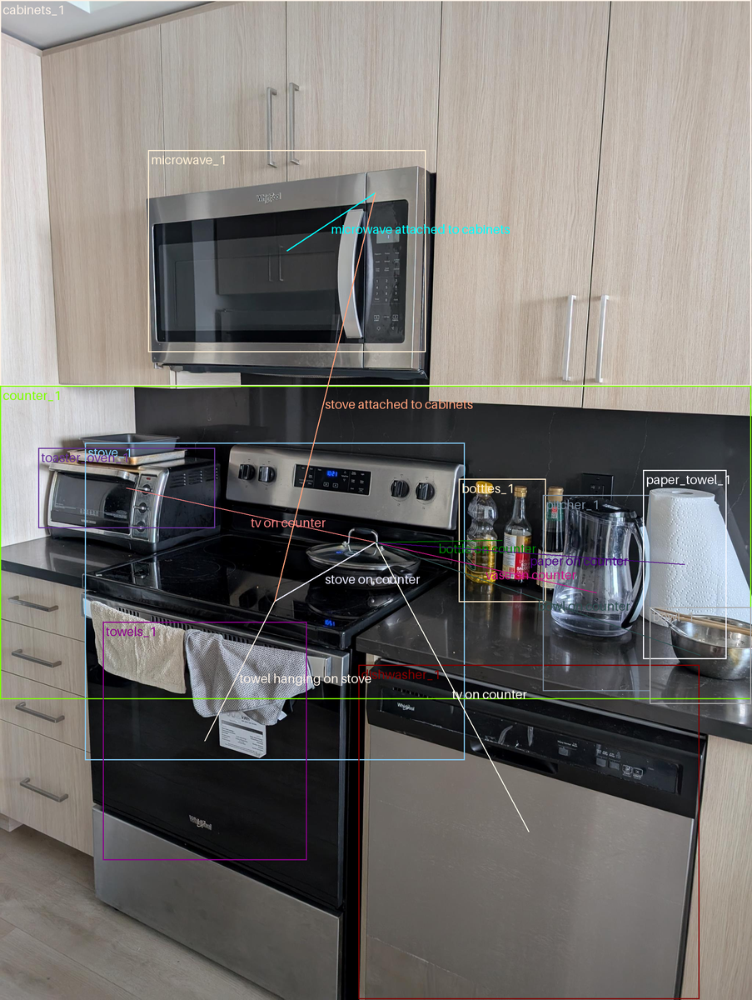

In [25]:
get_resized(kitchen_portrait)

## Video frames sample

In [19]:
# get video frame scene graphs
# TODO: do this asynchronously?
sample_scene_graphs = []
for i, frame in enumerate(sample_frames):
    graph = generate_scene_graph(frame)
    sample_scene_graphs.append(graph)

In [25]:
sample_scene_graphs_drawn = []
for frame, graph in zip(sample_frames, sample_scene_graphs):
    object_tuples = [(object_name, graph["objects"][object_name]["bounding_box"]) for object_name in graph["objects"]]
    plot_bounding_boxes(frame, object_tuples)
    draw_relationships(frame, graph, verbose=True)
    sample_scene_graphs_drawn.append(get_resized(frame).copy())

Skipping relation picture_1 on wall_1 because wall_1 not found in objects
Skipping relation counter_1 on wall_1 because wall_1 not found in objects
Skipped 2 relations


In [29]:
sample_scene_graphs[1]

{'objects': {'window_1': {'category': 258,
   'bounding_box': [0, 70, 470, 520],
   'attributes': [81, 23, 139]},
  'blinds_1': {'category': 21,
   'bounding_box': [0, 70, 280, 520],
   'attributes': [139, 76]},
  'table_1': {'category': 227,
   'bounding_box': [448, 0, 780, 226],
   'attributes': [142, 100, 117]},
  'chair_1': {'category': 49,
   'bounding_box': [480, 128, 740, 357],
   'attributes': [142, 110]},
  'chair_2': {'category': 49,
   'bounding_box': [650, 0, 999, 270],
   'attributes': [142, 110]},
  'chair_3': {'category': 49,
   'bounding_box': [408, 145, 581, 256],
   'attributes': [142, 110]},
  'cup_1': {'category': 66,
   'bounding_box': [445, 90, 490, 120],
   'attributes': [139, 100]},
  'cup_2': {'category': 66,
   'bounding_box': [445, 60, 500, 90],
   'attributes': [13, 100]},
  'counter_1': {'category': 63,
   'bounding_box': [405, 468, 999, 999],
   'attributes': [28, 6, 139]},
  'laptop_1': {'category': 125,
   'bounding_box': [585, 748, 725, 999],
   'attrib

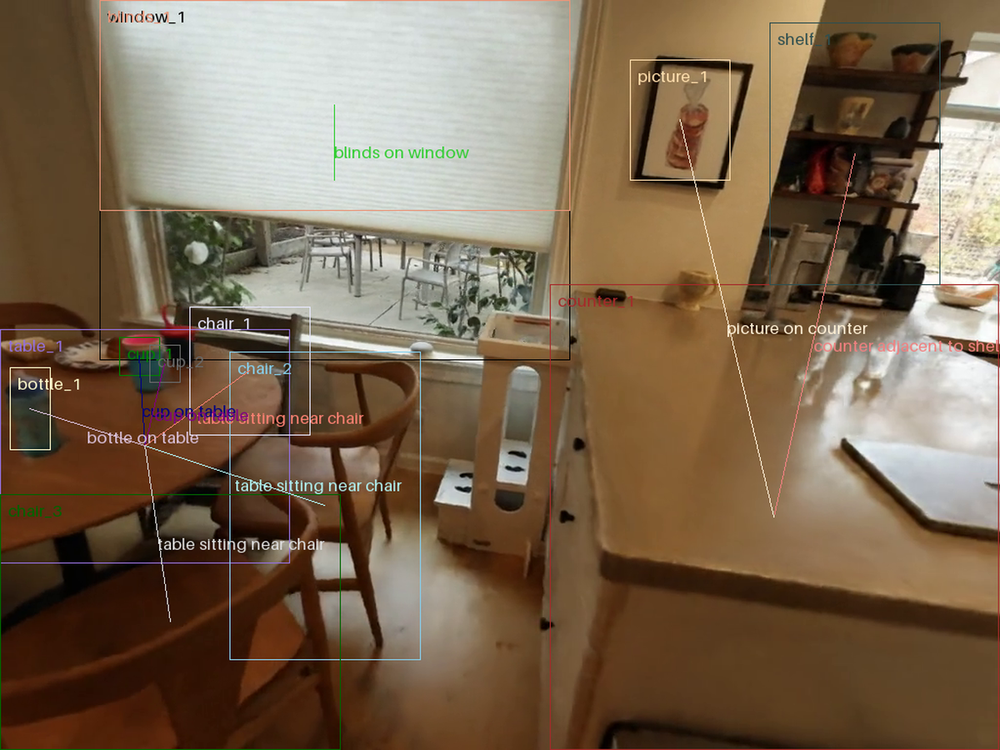

In [21]:
sample_scene_graphs_drawn[0]

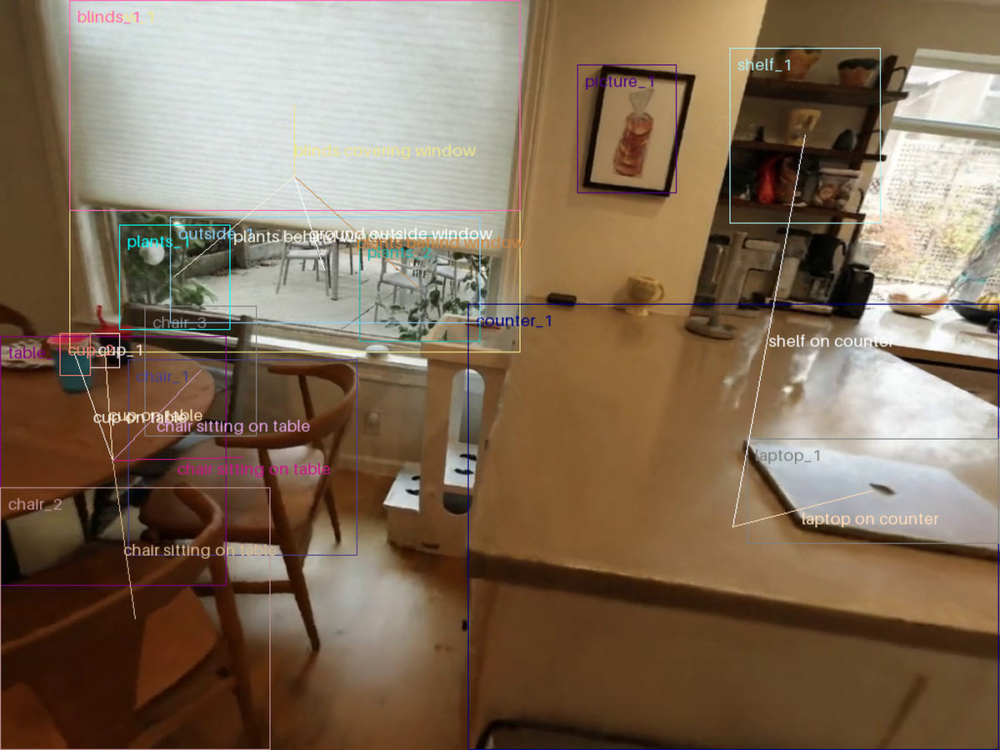

In [22]:
sample_scene_graphs_drawn[1]

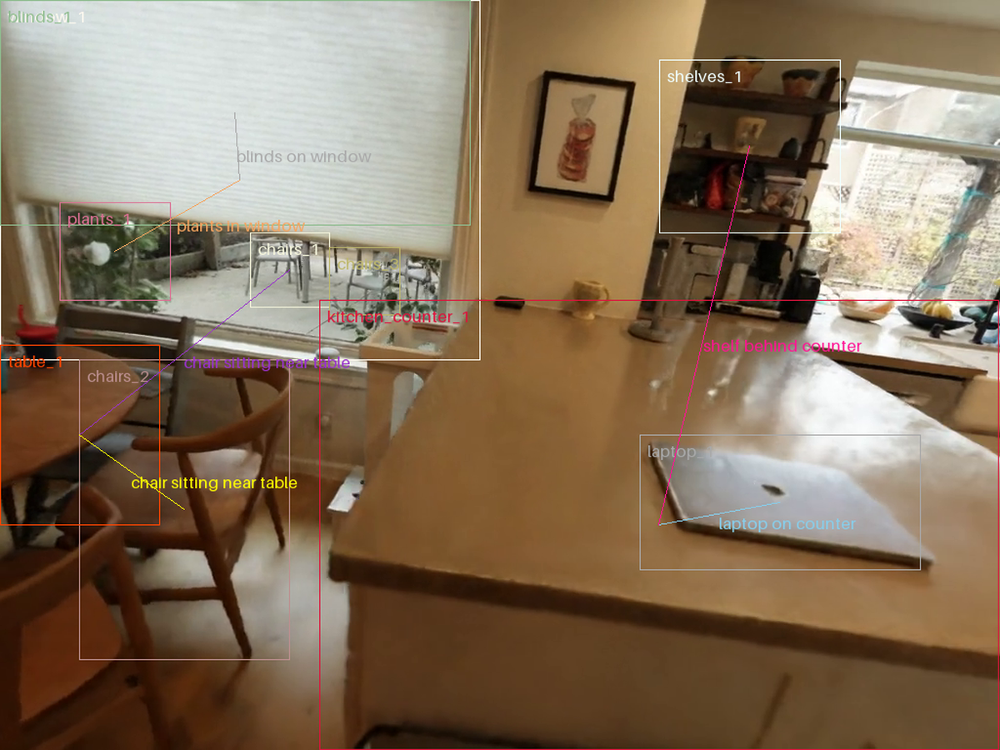

In [23]:
sample_scene_graphs_drawn[2]

## Longer sample

In [19]:
shortvid_scene_graphs = []
graph_file = "graphs/shortvid_scene_graphs.json"

# grab existing graphs
if os.path.exists(graph_file):
    with open(graph_file, "r") as f:
        shortvid_scene_graphs = json.load(f)
    print(f"Loaded {len(shortvid_scene_graphs)} scene graphs.")

# generate new graphs
else:
    for i, frame in enumerate(shortvid_frames):
        graph = generate_scene_graph(frame)
        shortvid_scene_graphs.append(graph)

    with open("graphs/shortvid_scene_graphs.json", "w") as f:
        f.write(json.dumps(shortvid_scene_graphs, indent=2))
    
    print(f"Generated {len(shortvid_scene_graphs)} scene graphs and saved to {graph_file}.")

Generated 60 scene graphs and saved to graphs/shortvid_scene_graphs.json.


In [22]:
shortvid_scene_graphs_drawn = []
errors = 0
for frame, graph in zip(shortvid_frames, shortvid_scene_graphs):
    object_tuples = [(object_name, graph["objects"][object_name]["bounding_box"]) for object_name in graph["objects"]]
    plot_bounding_boxes(frame, object_tuples)
    errors += draw_relationships(frame, graph)
    shortvid_scene_graphs_drawn.append(get_resized(frame).copy())

print(f"Total errors: {errors}")

Total errors: 18


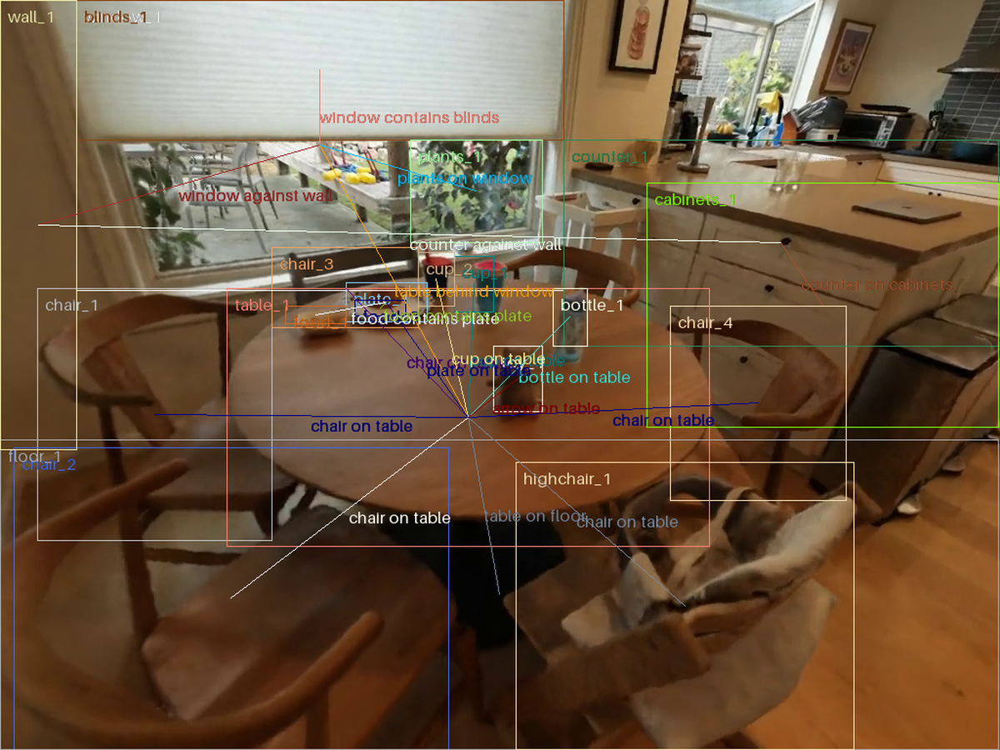

In [23]:
shortvid_scene_graphs_drawn[0]

In [25]:
generate_video("img/shortvid_scene_graphs_color.mp4", shortvid_scene_graphs_drawn)

# 2 Improving Consistency

In [47]:
sample_scene_graphs_2 = []
for i, frame in enumerate(sample_frames):
    graph = generate_scene_graph_with_context(frame, sample_scene_graphs_2[i-1] if i > 0 else None)
    sample_scene_graphs_2.append(graph)

In [48]:
[o["bounding_box"] for o in sample_scene_graphs_2[2]["objects"].values()]

[[16, 101, 447, 568],
 [16, 101, 107, 568],
 [264, 168, 432, 460],
 [376, 285, 496, 447],
 [672, 18, 946, 262],
 [421, 414, 633, 500],
 [408, 4, 947, 452],
 [403, 448, 998, 998],
 [592, 727, 702, 967],
 [415, 508, 462, 552],
 [20, 766, 300, 942],
 [81, 629, 214, 714],
 [0, 0, 999, 569]]

In [59]:
sample_scene_graphs_drawn_2 = []
for frame, graph in zip(sample_frames, sample_scene_graphs_2):
    object_tuples = [(object_name, graph["objects"][object_name]["bounding_box"]) for object_name in graph["objects"]]
    plot_bounding_boxes(frame, object_tuples)
    draw_relationships(frame, graph, verbose=True)
    sample_scene_graphs_drawn_2.append(get_resized(frame).copy())

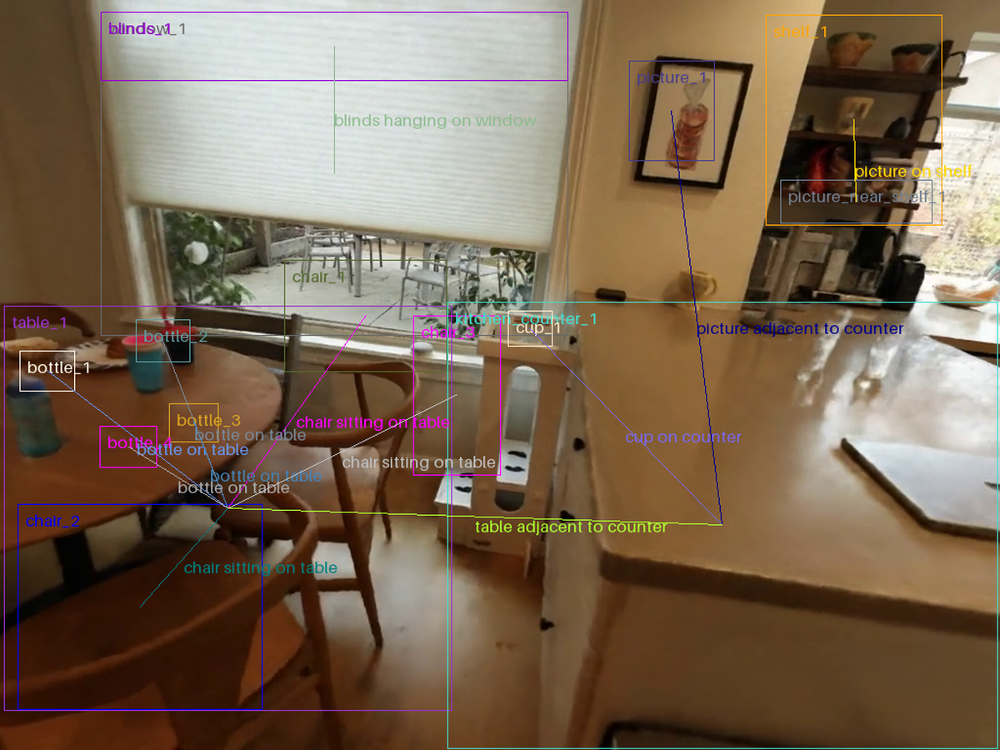

In [60]:
sample_scene_graphs_drawn_2[0]

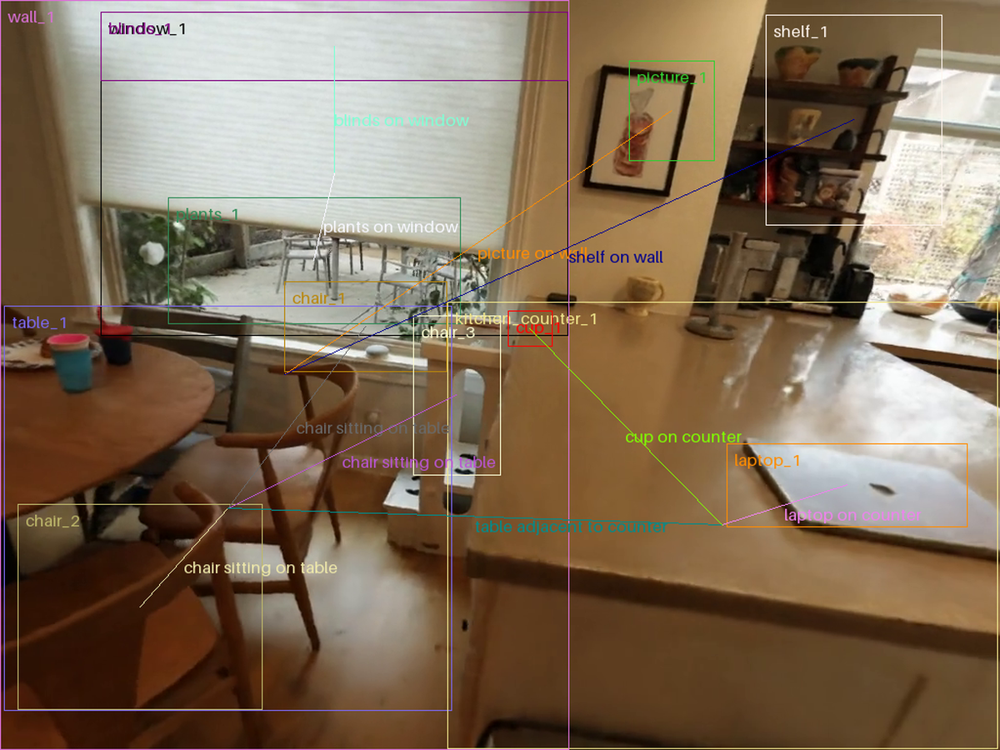

In [61]:
sample_scene_graphs_drawn_2[1]

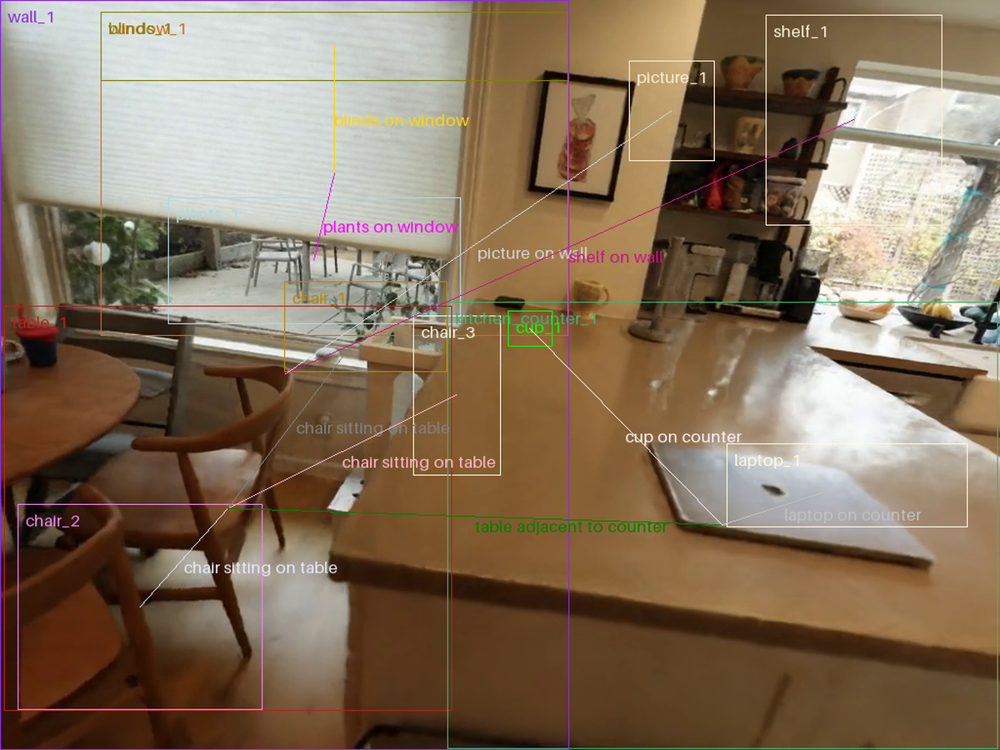

In [62]:
sample_scene_graphs_drawn_2[2]

# [TODO] (archive) Bounding Boxes -> Scene Graph

1. Generate bounding boxes
2. Refine bounding boxes
3. Generate scene graph

In [ ]:
# generate bounding boxes
response = model.generate_content(
    # input
    [
        img,
        """
        Return bounding boxes for all objects in the image using a JSON format. You
        must adhere to the following rules:
        1. Do not include any additional text.
        2. Use this JSON format:
        {
            "object_id": [ymin, xmin, ymax, xmax],
            "object_id2": [ymin, xmin, ymax, xmax],
            ...
        }
        3. You may create object_ids by using a word or short phrase to describe
        the object with a number, joined by underscores (eg. "book_1"). Object ids
        must be unique.
        """,
    ],
    # # configure to return json (broken, doesn't take dict)
    # generation_config={
    #     "response_mime_type": "application/json",
    #     "response_schema": dict[str, list[float]]
    # }
    # generation_config=genai.GenerationConfig(
    #     response_mime_type="application/json", response_schema=dict[str, int]
    # )
).text

objects = response_to_json(response)

{'oven_1': [451, 73, 568, 300],
 'microwave_1': [150, 196, 360, 568],
 'stove_1': [460, 111, 660, 613],
 'oven_2': [569, 115, 998, 470],
 'dishwasher_1': [696, 472, 998, 927],
 'cabinet_1': [0, 0, 400, 996],
 'counter_1': [400, 0, 998, 991],
 'towel_1': [592, 127, 839, 281],
 'towel_2': [680, 279, 895, 433],
 'bottle_1': [467, 618, 581, 671],
 'bottle_2': [470, 665, 585, 719],
 'bottle_3': [470, 705, 585, 754],
 'paper_towel_1': [482, 843, 665, 977],
 'bowl_1': [607, 855, 706, 1000]}

In [ ]:
objects

(3072, 4080)


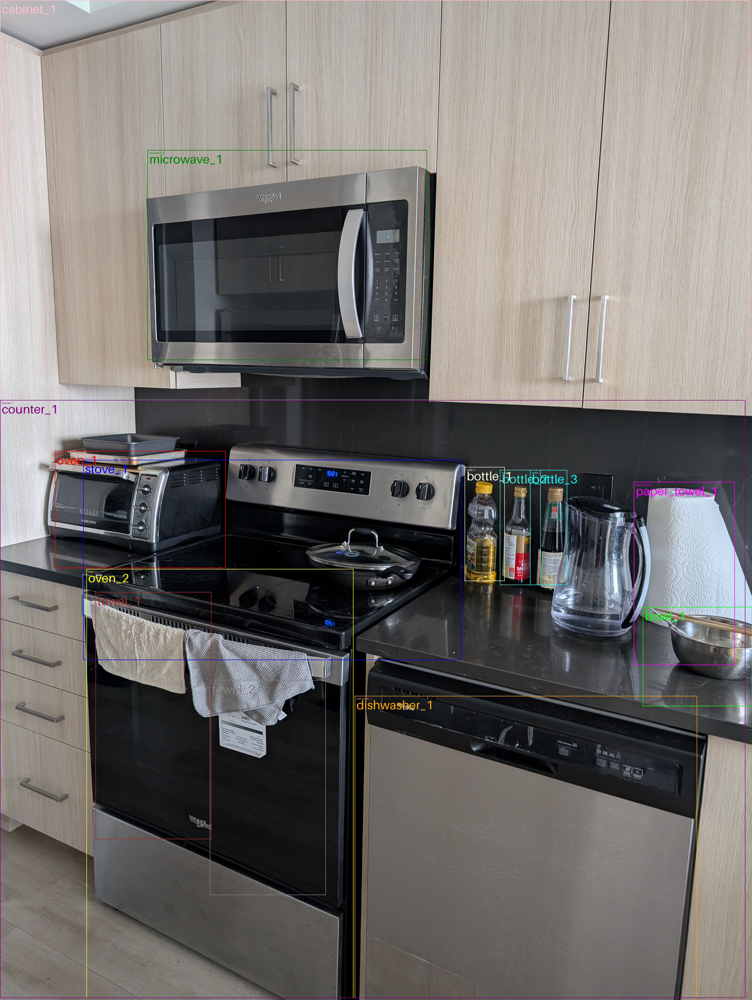

In [ ]:
plot_bounding_boxes(img, list(objects.items()))
img

In [ ]:
# TODO: refine bounding boxes

In [ ]:
prompt = """
Generate a scene graph for this image as a JSON. You must adhere to the following rules:
1. The JSON format is as follows:
{
    "objects": {
        "object_id": {
            "description
        }
    }
}
"""